<a href="https://colab.research.google.com/github/rioman/demo/blob/master/ComputerVision/object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install gluoncv
!pip install mxnet

In [ ]:
import os
import time
import pandas as pd
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.patches as patches

%matplotlib inline

from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import torch

# Model
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')

Downloading: "https://github.com/ultralytics/yolov5/archive/master.zip" to /root/.cache/torch/hub/master.zip
requirements: PyYAML>=5.3.1 not found and is required by YOLOv5, attempting auto-update...
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Attempting uninstall: PyYAML
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13

requirements: 1 package updated per /root/.cache/torch/hub/ultralytics_yolov5_master/requirements.txt
requirements: ⚠️ Restart runtime or rerun command for updates to take effect

YOLOv5 🚀 2022-6-14 Python-3.7.13 torch-1.11.0+cu113 CPU



  0%|          | 0.00/14.1M [00:00<?, ?B/s]


Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
Adding AutoShape... 


In [ ]:
filenames = [fn for fn in os.listdir('/content/gdrive/MyDrive/drones/drone/valid/') if fn.endswith('jpg')]
len(filenames)

698

In [ ]:
img = np.array(Image.open('/content/gdrive/MyDrive/drones/drone/valid/zrenjanin-serbia-august-2017-image-260nw-706305004_jpg.rf.53d2af0db319b4983d3787a3bec7677c.jpg'))
time_begin = time.time()
results = model(img)
time_end = time.time()

print(time_end - time_begin)

results.print()  # or .show(), .save(), .crop(), .pandas(), etc.

0.3558659553527832
image 1/1: 416x416 1 bird
Speed: 9.0ms pre-process, 345.1ms inference, 1.3ms NMS per image at shape (1, 3, 640, 640)


Total time: 25.6s	Mean time: 365ms


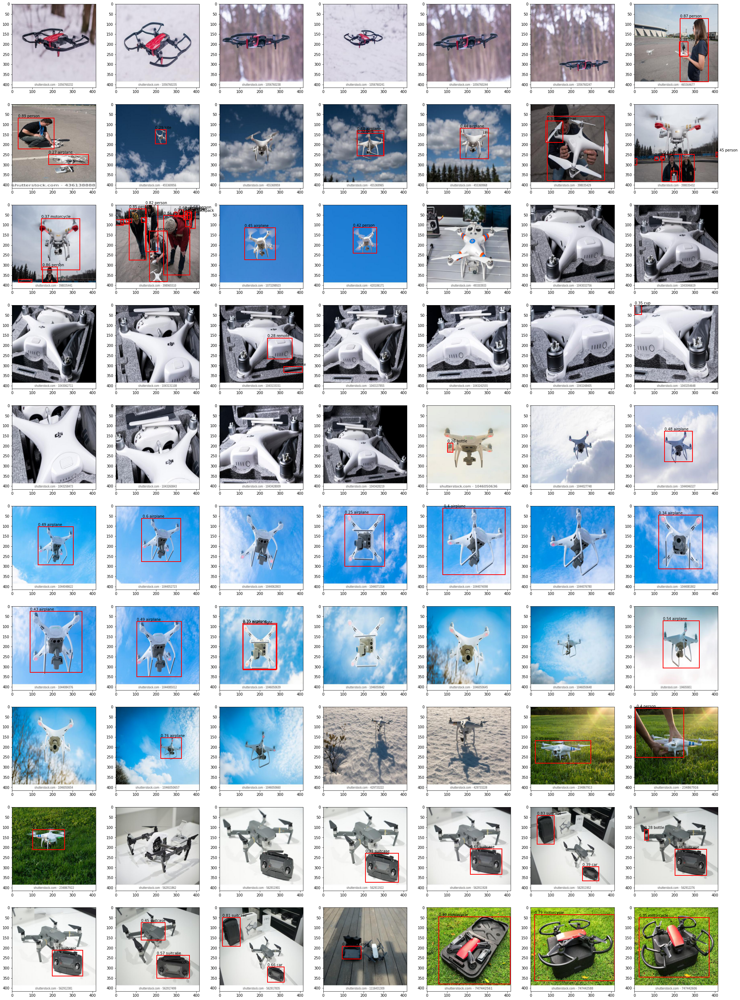

In [ ]:
start = 0
cols = 7
rows = 10
size = 35/cols

num = cols*rows
cum_time = 0.0

figure, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(35, size*rows))
for i in range(num):
    ax = axes[i // cols, i % cols]
    img = np.array(Image.open('/content/gdrive/MyDrive/drones/drone/valid/' + filenames[start+i]))
    results = model(img)
    cum_time += results.times[-1] - results.times[0]

    ax.imshow(img)
    for row in pd.concat(results.pandas().xyxy).itertuples():
        ax.add_patch(patches.Rectangle((row.xmin, row.ymin), row.xmax-row.xmin, row.ymax-row.ymin, edgecolor='r', linewidth=2, facecolor="none"))
        ax.text(row.xmin, row.ymin-4, f'{row.confidence:4.2} {row.name}')
print(f'Total time: {cum_time:4.3}s\tMean time: {round(1000*cum_time/num)}ms')

In [ ]:
from gluoncv import model_zoo, utils, data

In [ ]:
model_rcnn = model_zoo.get_model('faster_rcnn_resnet50_v1b_voc', pretrained=True)

Model file not found. Downloading.


121888KB [00:02, 45716.64KB/s]                            


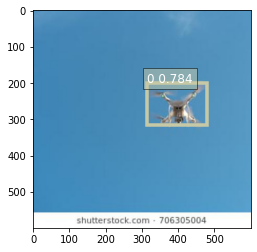

In [ ]:
x, orig_img = data.transforms.presets.rcnn.load_test('/content/gdrive/MyDrive/drones/drone/valid/zrenjanin-serbia-august-2017-image-260nw-706305004_jpg.rf.53d2af0db319b4983d3787a3bec7677c.jpg')
box_ids, scores, bboxes = model_rcnn(x)
ax = utils.viz.plot_bbox(orig_img, bboxes[0], scores[0], box_ids[0])

plt.show()

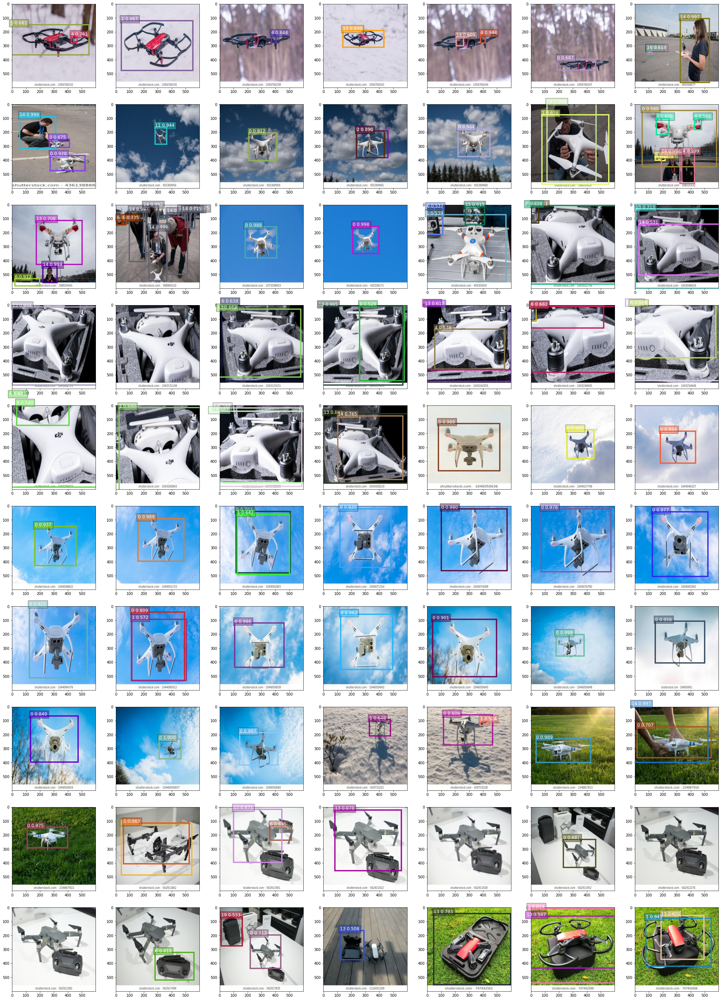

Model: faster_rcnn_resnet50_v1b_voc
Total time: 2.77s	Mean time: 40ms


In [122]:
model_name = 'faster_rcnn_resnet50_v1b_voc'
start = 0
cols = 7
rows = 10
size = 35/cols

model = model_zoo.get_model(model_name, pretrained=True)

num = cols*rows
cum_time = 0.0

figure, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(35, size*rows))
for i in range(num):
    ax = axes[i // cols, i % cols]
    x, orig_img = data.transforms.presets.rcnn.load_test('/content/gdrive/MyDrive/drones/drone/valid/' + filenames[start+i])
    time_start = time.time()
    box_ids, scores, bboxes = model(x)
    time_end = time.time()
    cum_time += time_end - time_start

    utils.viz.plot_bbox(orig_img, bboxes[0], scores[0], box_ids[0], ax=ax)
plt.show()
print(f'Model: {model_name}')
print(f'Total time: {cum_time:4.3}s\tMean time: {round(1000*cum_time/num)}ms')

Model file not found. Downloading.


223070KB [00:04, 50721.28KB/s]                            


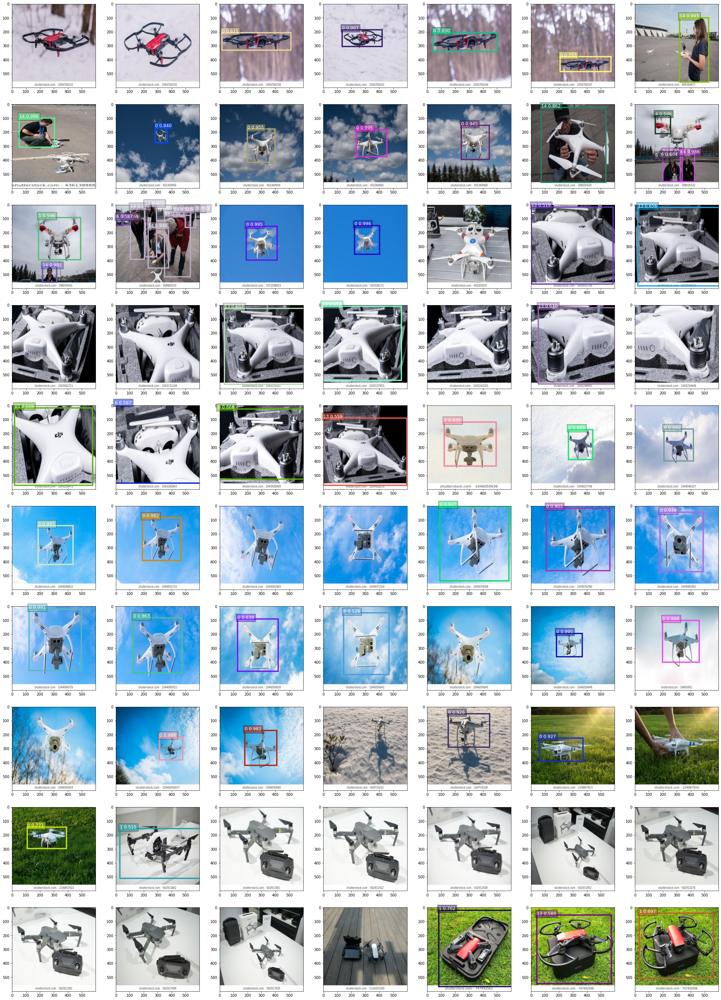

Model: yolo3_darknet53_voc
Total time: 3.57s	Mean time: 51ms


In [123]:
model_name = 'yolo3_darknet53_voc'
start = 0
cols = 7
rows = 10
size = 35/cols

model = model_zoo.get_model(model_name, pretrained=True)

num = cols*rows
cum_time = 0.0

figure, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(35, size*rows))
for i in range(num):
    ax = axes[i // cols, i % cols]
    x, orig_img = data.transforms.presets.rcnn.load_test('/content/gdrive/MyDrive/drones/drone/valid/' + filenames[start+i])
    time_start = time.time()
    box_ids, scores, bboxes = model(x)
    time_end = time.time()
    cum_time += time_end - time_start

    utils.viz.plot_bbox(orig_img, bboxes[0], scores[0], box_ids[0], ax=ax)
plt.show()
print(f'Model: {model_name}')
print(f'Total time: {cum_time:4.3}s\tMean time: {round(1000*cum_time/num)}ms')

/usr/local/lib/python3.7/dist-packages/mxnet/gluon/block.py:1784: UserWarning: Cannot decide type for the following arguments. Consider providing them as input:
	data: None
  input_sym_arg_type = in_param.infer_type()[0]
Model file not found. Downloading.


100%|██████████| 132723/132723 [00:02<00:00, 46337.58KB/s]


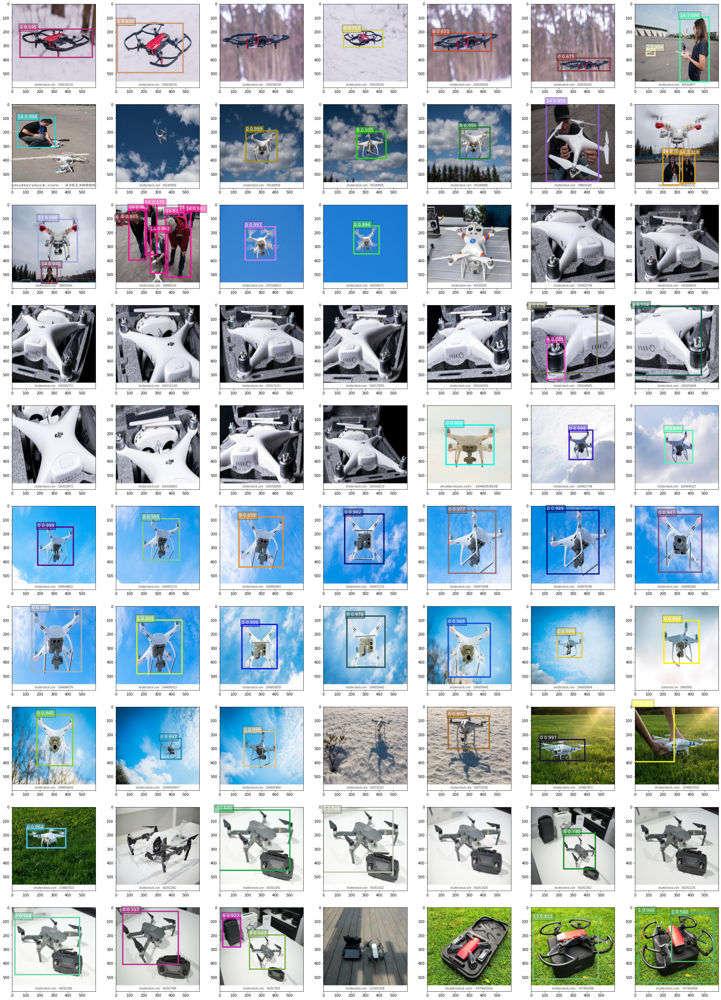

Model: ssd_512_resnet50_v1_voc
Total time: 1.25s	Mean time: 18ms


In [124]:
model_name = 'ssd_512_resnet50_v1_voc'
start = 0
cols = 7
rows = 10
size = 35/cols

model = model_zoo.get_model(model_name, pretrained=True)

num = cols*rows
cum_time = 0.0

figure, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(35, size*rows))
for i in range(num):
    ax = axes[i // cols, i % cols]
    x, orig_img = data.transforms.presets.rcnn.load_test('/content/gdrive/MyDrive/drones/drone/valid/' + filenames[start+i])
    time_start = time.time()
    box_ids, scores, bboxes = model(x)
    time_end = time.time()
    cum_time += time_end - time_start

    utils.viz.plot_bbox(orig_img, bboxes[0], scores[0], box_ids[0], ax=ax)
plt.show()
print(f'Model: {model_name}')
print(f'Total time: {cum_time:4.3}s\tMean time: {round(1000*cum_time/num)}ms')

Model file not found. Downloading.


109148KB [00:02, 36796.68KB/s]                            


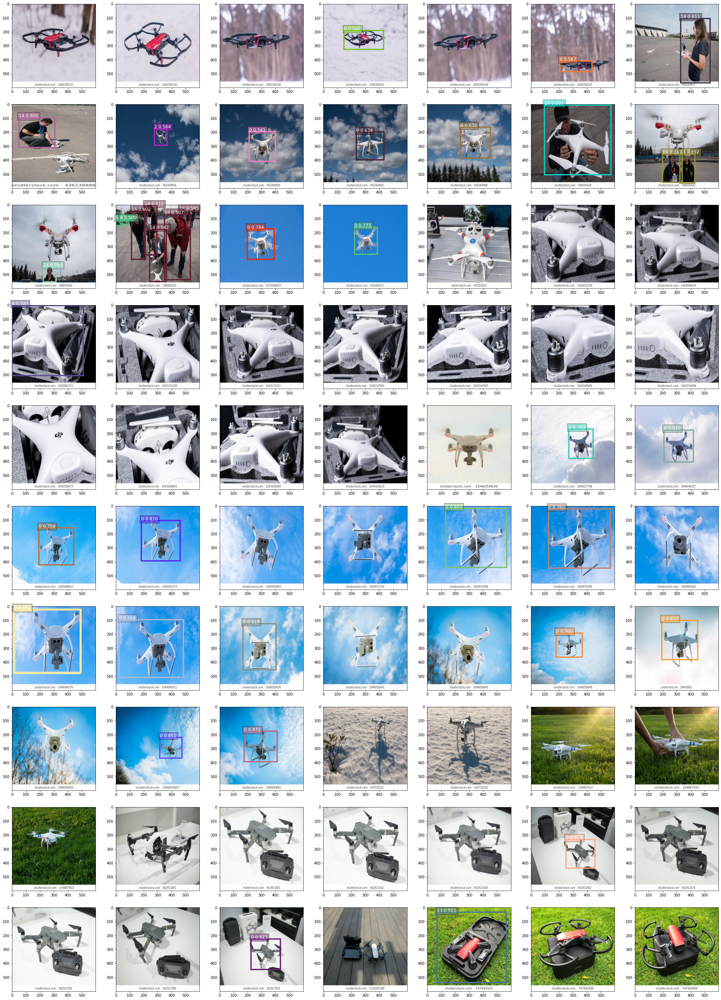

Model: center_net_resnet50_v1b_voc
Total time: 2.59s	Mean time: 37ms


In [125]:
model_name = 'center_net_resnet50_v1b_voc'
start = 0
cols = 7
rows = 10
size = 35/cols

model = model_zoo.get_model(model_name, pretrained=True)

num = cols*rows
cum_time = 0.0

figure, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(35, size*rows))
for i in range(num):
    ax = axes[i // cols, i % cols]
    x, orig_img = data.transforms.presets.rcnn.load_test('/content/gdrive/MyDrive/drones/drone/valid/' + filenames[start+i])
    time_start = time.time()
    box_ids, scores, bboxes = model(x)
    time_end = time.time()
    cum_time += time_end - time_start

    utils.viz.plot_bbox(orig_img, bboxes[0], scores[0], box_ids[0], ax=ax)
plt.show()
print(f'Model: {model_name}')
print(f'Total time: {cum_time:4.3}s\tMean time: {round(1000*cum_time/num)}ms')

In [ ]:
model_name = ''
start = 0
cols = 7
rows = 10
size = 35/cols

model = model_zoo.get_model(model_name, pretrained=True)

num = cols*rows
cum_time = 0.0

figure, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(35, size*rows))
for i in range(num):
    ax = axes[i // cols, i % cols]
    x, orig_img = data.transforms.presets.rcnn.load_test('/content/gdrive/MyDrive/drones/drone/valid/' + filenames[start+i])
    time_start = time.time()
    box_ids, scores, bboxes = model(x)
    time_end = time.time()
    cum_time += time_end - time_start

    utils.viz.plot_bbox(orig_img, bboxes[0], scores[0], box_ids[0], ax=ax)
plt.show()
print(f'Model: {model_name}')
print(f'Total time: {cum_time:4.3}s\tMean time: {round(1000*cum_time/num)}ms')